In [ ]:
!pip install powerlaw

import pandas as pd
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import powerlaw

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Load the consolidated  dataset
file_path = '/content/drive/My Drive/FinalSN.csv'
data= pd.read_csv(file_path, encoding= 'latin', engine= 'python')

# Load the datasets for direct and indirect connections
file_path_direct = '/content/drive/My Drive/FinalSN.csv'
file_path_indirect = '/content/drive/My Drive/SNC03.csv'

data_direct = pd.read_csv(file_path_direct, encoding='latin', engine='python')
data_indirect = pd.read_csv(file_path_indirect, encoding='latin', engine='python')


# **Compute Network Metrics**

In [ ]:
def create_adjacency_matrix(data):
    companies = list(set(data['ISIN_x']).union(set(data['ISIN_y'])))
    company_index = {company: idx for idx, company in enumerate(companies)}

    n = len(companies)
    adjacency_matrix = np.zeros((n, n))

    for _, row in data.iterrows():
        i = company_index[row['ISIN_x']]
        j = company_index[row['ISIN_y']]
        adjacency_matrix[i][j] = 1
        adjacency_matrix[j][i] = 1  # Ensure the matrix is symmetric

    return adjacency_matrix, companies

def calculate_connectedness(adjacency_matrix):
    n = len(adjacency_matrix)
    reachable_pairs = np.sum(adjacency_matrix)
    connectedness = reachable_pairs / (n * (n - 1))
    return connectedness

def calculate_connectedness_and_fragmentation(data, years):
    metrics = []
    for year in years:
        yearly_data = data[data['year'] == year]
        if yearly_data.empty:
            continue

        adjacency_matrix, _ = create_adjacency_matrix(yearly_data)
        connectedness = calculate_connectedness(adjacency_matrix)
        fragmentation = 1 - connectedness

        metrics.append({
            'Year': year,
            'Connectedness': connectedness,
            'Fragmentation': fragmentation,
        })

    return metrics

def calculate_connectedness_and_fragmentation_by_sector(data, years, sectors):
    metrics = []
    for year in years:
        for sector in sectors:
            sector_data = data[(data['year'] == year) & (data['Sector_x'] == sector)]
            if sector_data.empty:
                continue

            adjacency_matrix, _ = create_adjacency_matrix(sector_data)
            connectedness = calculate_connectedness(adjacency_matrix)
            fragmentation = 1 - connectedness

            metrics.append({
                'Year': year,
                'Sector': sector,
                'Connectedness': connectedness,
                'Fragmentation': fragmentation,
            })

    return metrics


def analyze_components(data, years):
    components_metrics = []
    for year in years:
        yearly_data = data[data['year'] == year]
        G = nx.Graph()
        G.add_edges_from(zip(yearly_data['ISIN_x'], yearly_data['ISIN_y']))

        components = sorted(nx.connected_components(G), key=len, reverse=True)
        largest_component_size = len(components[0]) if components else 0
        other_components_sizes = [len(component) for component in components[1:]]  # Exclude the largest component

        mean_size = sum(other_components_sizes) / len(other_components_sizes) if other_components_sizes else 0
        median_size = pd.Series(other_components_sizes).median() if other_components_sizes else 0
        std_dev_size = pd.Series(other_components_sizes).std() if other_components_sizes else 0

        components_metrics.append({
            'Year': year,
            'Largest_Component_Size': largest_component_size,
            'Mean_Size_Excluding_Largest': mean_size,
            'Median_Size_Excluding_Largest': median_size,
            'Std_Dev_Size_Excluding_Largest': std_dev_size
        })

    return components_metrics

def calculate_largest_component_metrics(data, years):
    metrics = []
    for year in years:
        yearly_data = data[data['year'] == year]
        G = nx.Graph()
        G.add_edges_from(zip(yearly_data['ISIN_x'], yearly_data['ISIN_y']))

        largest_component = max(nx.connected_components(G), key=len, default=[])
        G_largest = G.subgraph(largest_component).copy()

        size = G_largest.number_of_nodes()
        density = nx.density(G_largest)
        avg_degree = sum(dict(G_largest.degree()).values()) / size if size > 0 else 0

        betweenness_centrality = nx.betweenness_centrality(G_largest)
        closeness_centrality = nx.closeness_centrality(G_largest)

        avg_betweenness = sum(betweenness_centrality.values()) / len(betweenness_centrality) if betweenness_centrality else 0
        avg_closeness = sum(closeness_centrality.values()) / len(closeness_centrality) if closeness_centrality else 0

        metrics.append({
            'Year': year,
            'Largest_Component_Size': size,
            'Density': density,
            'Average_Degree': avg_degree,
            'Average_Betweenness': avg_betweenness,
            'Average_Closeness': avg_closeness
        })

    return metrics

def calculate_network_metrics(data, years, sectors):
    network_metrics = []
    for year in years:
        for sector in sectors:
            yearly_data = data[(data['year'] == year) & (data['Sector_x'] == sector)]
            G = nx.Graph()
            G.add_edges_from(zip(yearly_data['ISIN_x'], yearly_data['ISIN_y']))

            size = G.number_of_nodes()
            density = nx.density(G)
            avg_degree = sum(dict(G.degree()).values()) / size if size > 0 else 0

            betweenness_centrality = nx.betweenness_centrality(G)
            closeness_centrality = nx.closeness_centrality(G)
            components = nx.number_connected_components(G)

            avg_betweenness = sum(betweenness_centrality.values()) / len(betweenness_centrality) if betweenness_centrality else 0
            avg_closeness = sum(closeness_centrality.values()) / len(closeness_centrality) if closeness_centrality else 0

            network_metrics.append({
                'Year': year,
                'Sector': sector,
                'Size': size,
                'Density': density,
                'Degree': avg_degree,
                'Betweenness': avg_betweenness,
                'Closeness': avg_closeness,
                'Components': components
            })

    return network_metrics

years = data['year'].unique()
sectors = data['Sector_x'].unique()

# Create dataframes
connectedness_fragmentation_by_sector_metrics = calculate_connectedness_and_fragmentation_by_sector(data, years, sectors)
connectedness_fragmentation_by_sector_df = pd.DataFrame(connectedness_fragmentation_by_sector_metrics)

connectedness_fragmentation_metrics = calculate_connectedness_and_fragmentation(data, years)
connectedness_fragmentation_df = pd.DataFrame(connectedness_fragmentation_metrics)

components_metrics = analyze_components(data, years)
components_df = pd.DataFrame(components_metrics)

largest_component_metrics = calculate_largest_component_metrics(data, years)
largest_component_metrics_df = pd.DataFrame(largest_component_metrics)

network_metrics = calculate_network_metrics(data, years, sectors)
network_metrics_df = pd.DataFrame(network_metrics)


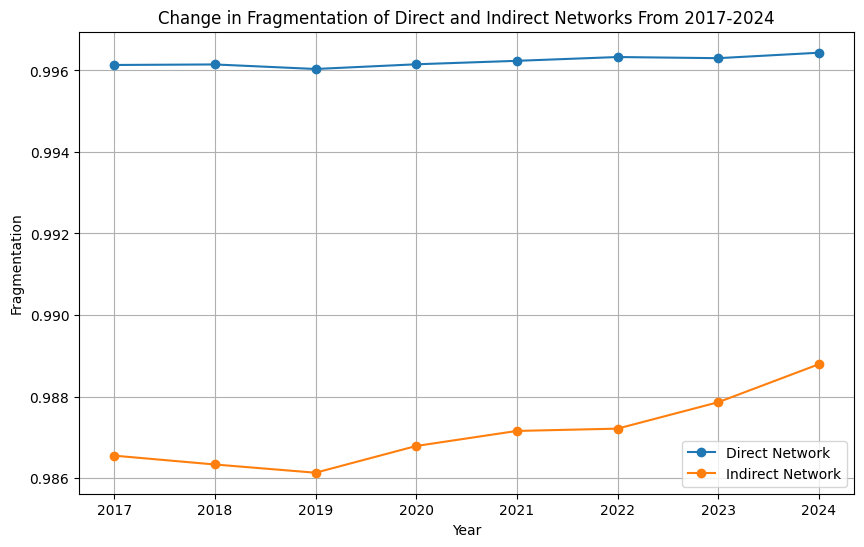

In [ ]:
# Function to process and plot fragmentation of both direct and indirect networks
def analyze_and_plot_fragmentation(data_direct, data_indirect):
    years = sorted(data_direct['year'].unique())

    metrics_direct = calculate_connectedness_and_fragmentation(data_direct, years)
    metrics_indirect = calculate_connectedness_and_fragmentation(data_indirect, years)

    df_metrics_direct = pd.DataFrame(metrics_direct)
    df_metrics_indirect = pd.DataFrame(metrics_indirect)

    # Plot  fragmentation trends
    plt.figure(figsize=(10, 6))
    plt.plot(df_metrics_direct['Year'], df_metrics_direct['Fragmentation'], label='Direct Network', marker='o')
    plt.plot(df_metrics_indirect['Year'], df_metrics_indirect['Fragmentation'], label='Indirect Network', marker='o')
    plt.xlabel('Year')
    plt.ylabel('Fragmentation')
    plt.title('Change in Fragmentation of Direct and Indirect Networks From 2017-2024')
    plt.legend()
    plt.grid(True)
    plt.show()

# Run the analysis and plot
analyze_and_plot_fragmentation(data_direct, data_indirect)

In [ ]:
# Function to calculate fragmentatino and connectedness by sector
def calculate_sectoral_metrics(data, years):
    sectors = data['Sector_x'].unique()
    sector_metrics = {}

    for sector in sectors:
        sector_metrics[sector] = []
        for year in years:
            yearly_data = data[data['year'] == year]
            sector_data = yearly_data[yearly_data['Sector_x'] == sector]

            if sector_data.empty:
                continue

            total_network_size = len(set(yearly_data['ISIN_x']).union(set(yearly_data['ISIN_y'])))
            sector_size = len(set(sector_data['ISIN_x']).union(set(sector_data['ISIN_y'])))
            sector_proportion = sector_size / total_network_size if total_network_size > 0 else 0

            adjacency_matrix, _ = create_adjacency_matrix(sector_data)
            connectedness = calculate_connectedness(adjacency_matrix)
            fragmentation = 1 - connectedness

            sector_metrics[sector].append({
                'Year': year,
                'Connectedness': connectedness,
                'Fragmentation': fragmentation,
                'Sector_Proportion': sector_proportion
            })

    return sector_metrics

# Function to filter sectors that comprise 80% of the network
def filter_top_sectors(sector_metrics, years):
    top_sectors = {}
    for year in years:
        year_sector_data = []
        for sector, metrics in sector_metrics.items():
            for metric in metrics:
                if metric['Year'] == year:
                    year_sector_data.append({
                        'Sector': sector,
                        'Sector_Proportion': metric['Sector_Proportion']
                    })
        year_sector_data = sorted(year_sector_data, key=lambda x: x['Sector_Proportion'], reverse=True)

        cumulative_proportion = 0
        selected_sectors = []
        for sector_info in year_sector_data:
            cumulative_proportion += sector_info['Sector_Proportion']
            selected_sectors.append(sector_info['Sector'])
            if cumulative_proportion >= 0.8:
                break
        top_sectors[year] = selected_sectors
    return top_sectors

# Function to plot filtered sectors
def plot_filtered_sectoral_trends(sector_metrics, top_sectors, title):
    plt.figure(figsize=(12, 8))
    for sector in set([s for year_sectors in top_sectors.values() for s in year_sectors]):
        sector_data = [metric for metric in sector_metrics[sector] if metric['Year'] in years]
        if sector_data:
            df = pd.DataFrame(sector_data)
            plt.plot(df['Year'], df['Fragmentation'], label=sector, marker='o')
    plt.xlabel('Year')
    plt.ylabel('Fragmentation')
    plt.title(title)
    plt.legend(loc='best')
    plt.grid(True)
    plt.show()

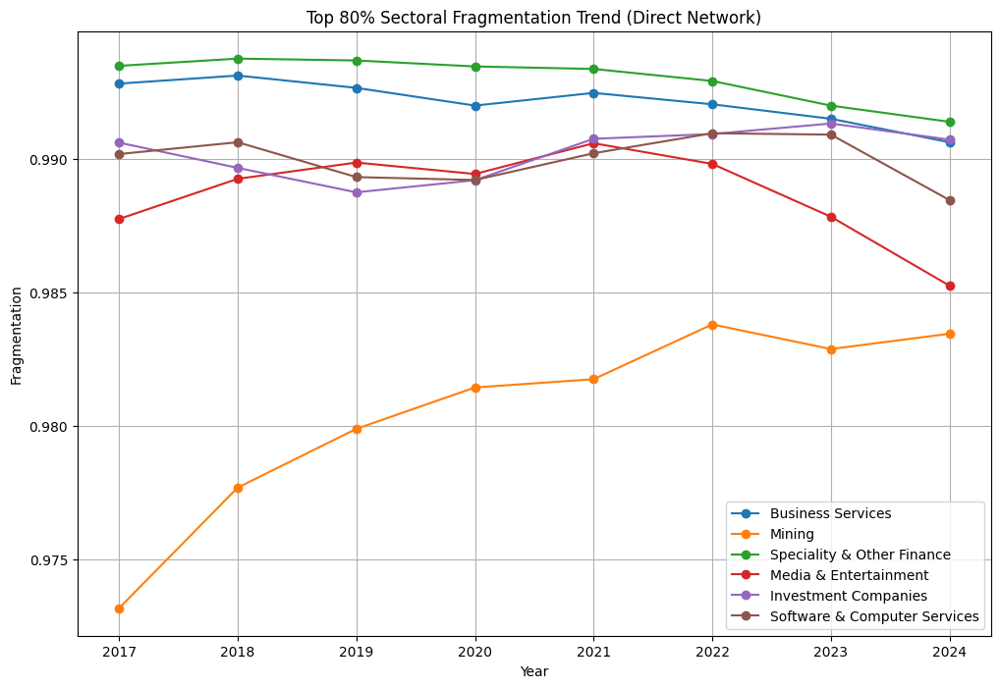

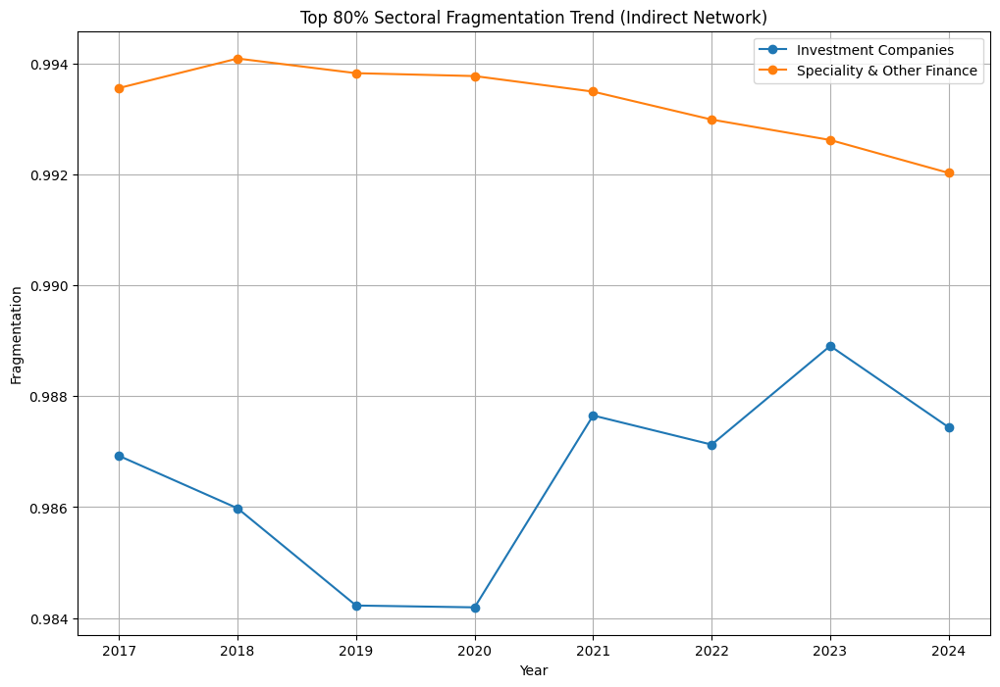

In [ ]:

sector_metrics_direct = calculate_sectoral_metrics(data_direct, years)
sector_metrics_indirect = calculate_sectoral_metrics(data_indirect, years)


top_sectors_direct = filter_top_sectors(sector_metrics_direct, years)
top_sectors_indirect = filter_top_sectors(sector_metrics_indirect, years)

# Plot the sectoral fragmentation trends for the top 80% of sectors in the direct and indirect networks
plot_filtered_sectoral_trends(sector_metrics_direct, top_sectors_direct, 'Top 80% Sectoral Fragmentation Trend (Direct Network)')
plot_filtered_sectoral_trends(sector_metrics_indirect, top_sectors_indirect, 'Top 80% Sectoral Fragmentation Trend (Indirect Network)')

In [ ]:
connectedness_fragmentation_df

,Year,Connectedness,Fragmentation
0,2017,0.003865,0.996135
1,2018,0.003852,0.996148
2,2019,0.003964,0.996036
3,2020,0.003849,0.996151
4,2021,0.003764,0.996236
5,2022,0.003670,0.996330
6,2023,0.003698,0.996302
7,2024,0.003565,0.996435


In [ ]:
connectedness_fragmentation_by_sector_df

,Year,Sector,Connectedness,Fragmentation
0,2017,Investment Companies,0.009404,0.990596
1,2017,Business Services,0.007194,0.992806
2,2017,Engineering & Machinery,0.018872,0.981128
3,2017,Leisure & Hotels,0.013411,0.986589
4,2017,Food Producers & Processors,0.026232,0.973768
...,...,...,...,...
335,2024,Electricity,0.177778,0.822222
336,2024,Legal,0.120879,0.879121
337,2024,Private Equity,0.109890,0.890110
338,2024,Forestry & Paper,1.000000,0.000000


In [ ]:
components_df

,Year,Largest_Component_Size,Mean_Size_Excluding_Largest,Median_Size_Excluding_Largest,Std_Dev_Size_Excluding_Largest
0,2017,1385,2.500000,2.0,0.896617
1,2018,1422,2.259259,2.0,0.520710
2,2019,1359,2.648148,2.0,1.429572
3,2020,1355,2.357143,2.0,0.698793
4,2021,1456,2.350000,2.0,0.802240
5,2022,1438,2.215686,2.0,0.461030
6,2023,1358,2.367347,2.0,0.667516
7,2024,1226,2.698113,2.0,1.635953


In [ ]:
largest_component_metrics_df

,Year,Largest_Component_Size,Density,Average_Degree,Average_Betweenness,Average_Closeness
0,2017,1040,0.014628,15.198077,0.002397,0.294874
1,2018,1069,0.014790,15.796071,0.002300,0.297546
2,2019,1030,0.015651,16.104854,0.002344,0.300905
3,2020,1036,0.014329,14.830116,0.002380,0.295164
4,2021,1092,0.013663,14.906593,0.002245,0.296599
5,2022,1074,0.013530,14.517691,0.002365,0.289593
6,2023,1023,0.013140,13.429130,0.002643,0.278004
7,2024,876,0.013174,11.527397,0.003329,0.264246


In [ ]:
network_metrics_df

,Year,Sector,Size,Density,Degree,Betweenness,Closeness,Components
0,2017,Investment Companies,504,0.009404,4.730159,0.006149,0.177719,17
1,2017,Business Services,276,0.007194,1.978261,0.004929,0.049508,34
2,2017,Engineering & Machinery,92,0.018872,1.717391,0.006782,0.053501,16
3,2017,Leisure & Hotels,154,0.013411,2.051948,0.005857,0.045165,22
4,2017,Food Producers & Processors,67,0.026232,1.731343,0.001621,0.059020,13
...,...,...,...,...,...,...,...,...
339,2024,Electricity,10,0.177778,1.600000,0.058333,0.393162,2
340,2024,Legal,14,0.120879,1.571429,0.015568,0.201640,3
341,2024,Private Equity,14,0.109890,1.428571,0.014652,0.188478,4
342,2024,Forestry & Paper,2,1.000000,1.000000,0.000000,1.000000,1


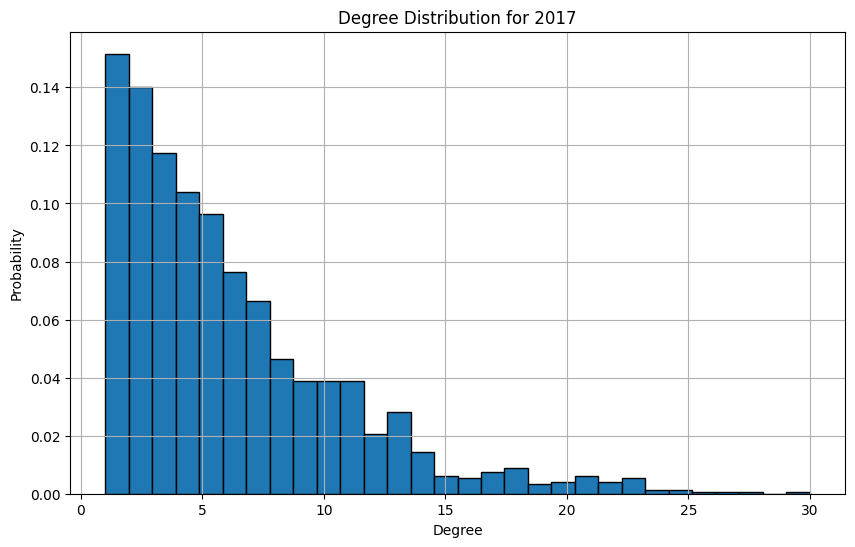

Year: 2017, Average Degree: 5.852145214521452


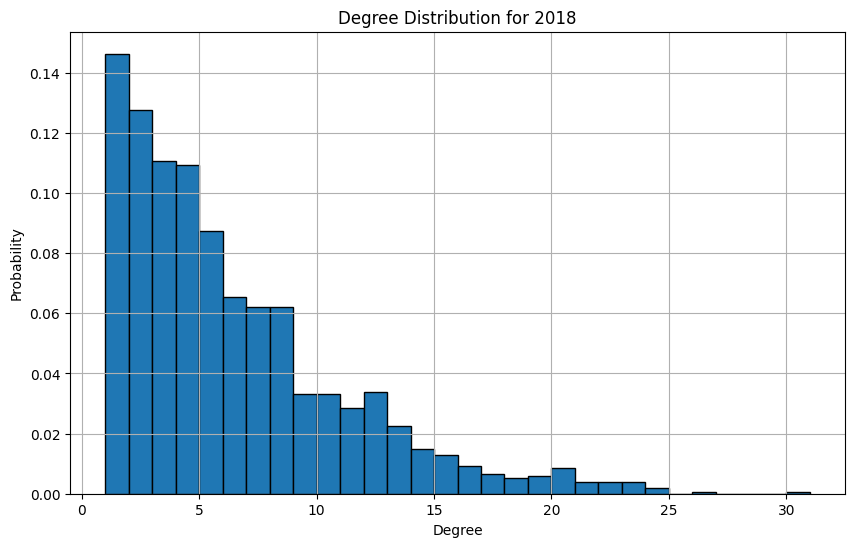

Year: 2018, Average Degree: 5.944300518134715


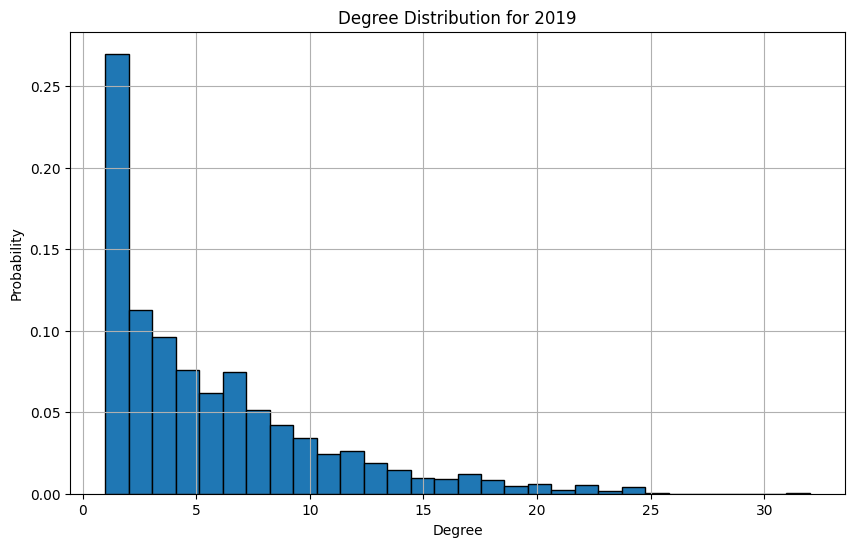

Year: 2019, Average Degree: 5.949400798934754


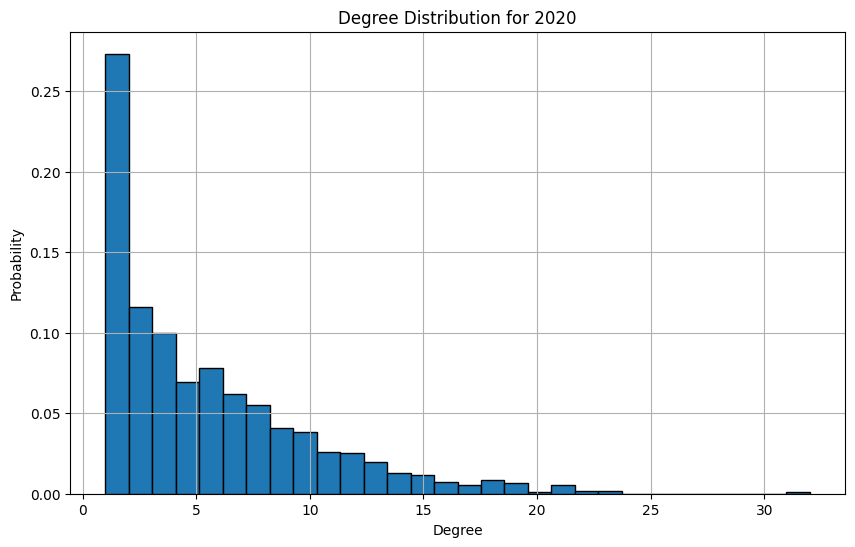

Year: 2020, Average Degree: 5.718897108271688


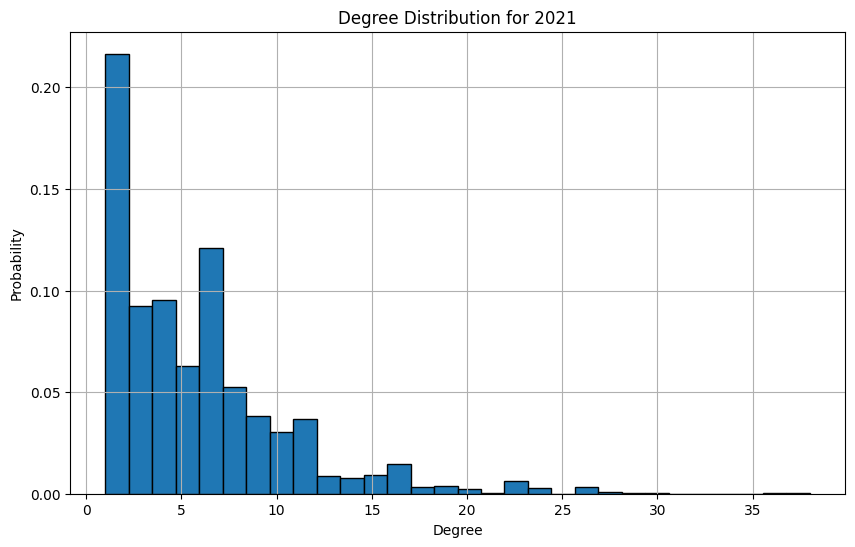

Year: 2021, Average Degree: 5.829677419354839


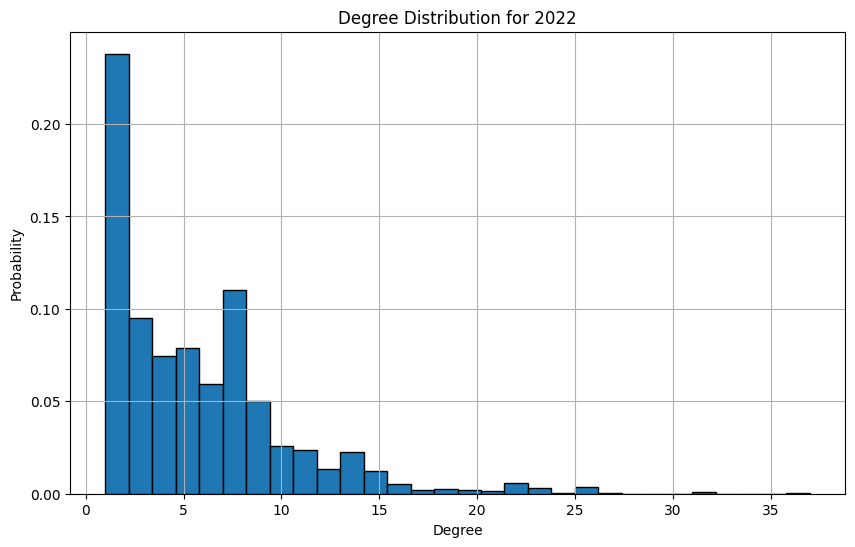

Year: 2022, Average Degree: 5.68923275306254


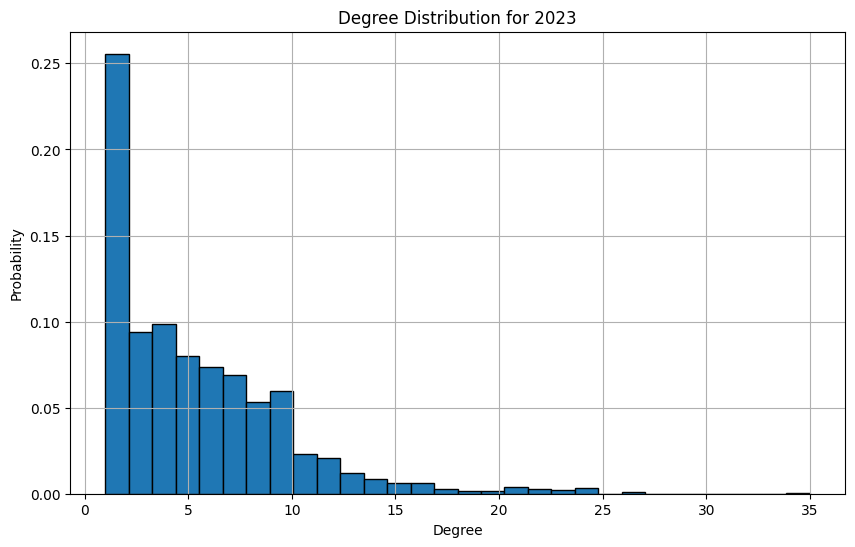

Year: 2023, Average Degree: 5.447761194029851


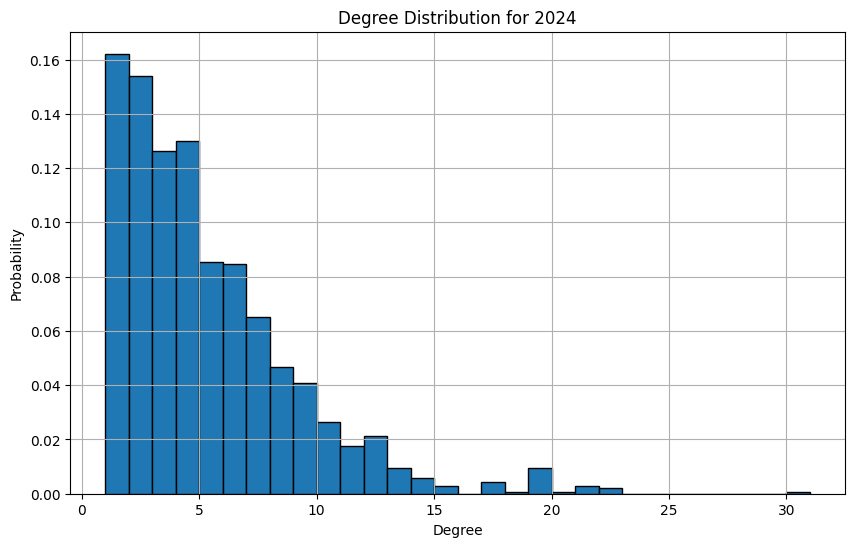

Year: 2024, Average Degree: 4.876552227903579


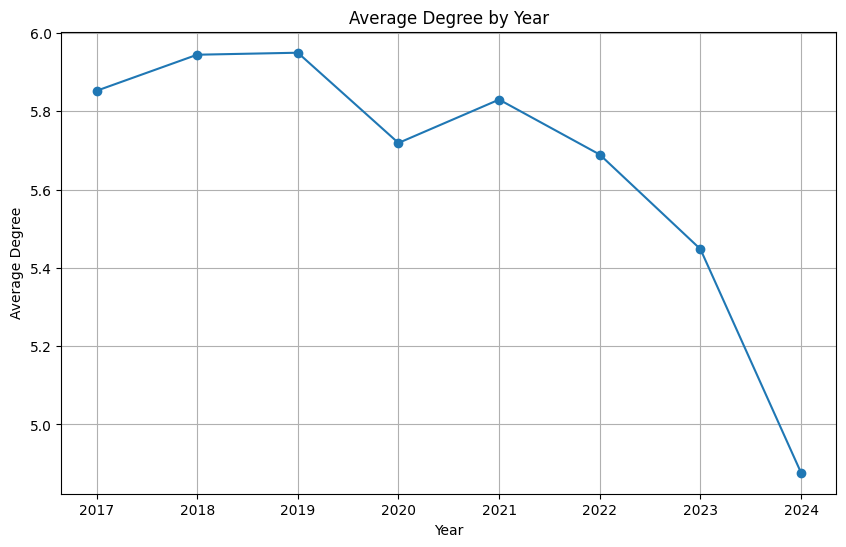

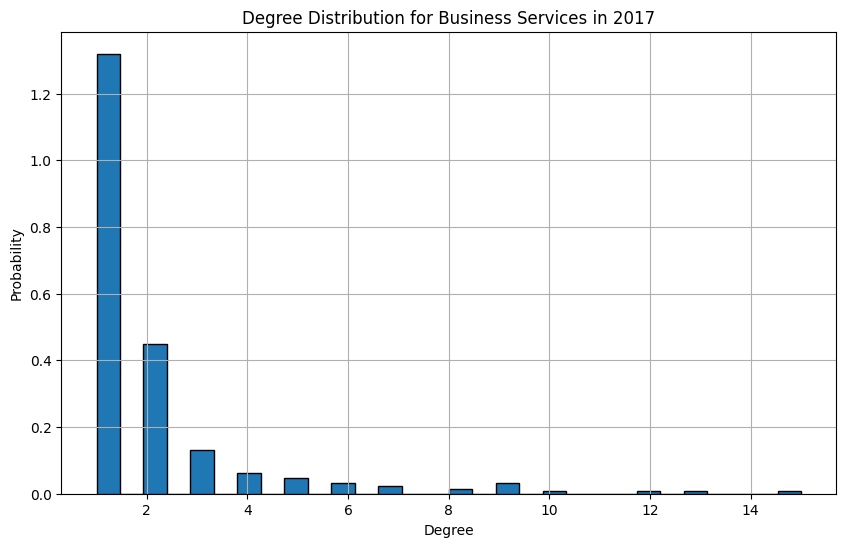

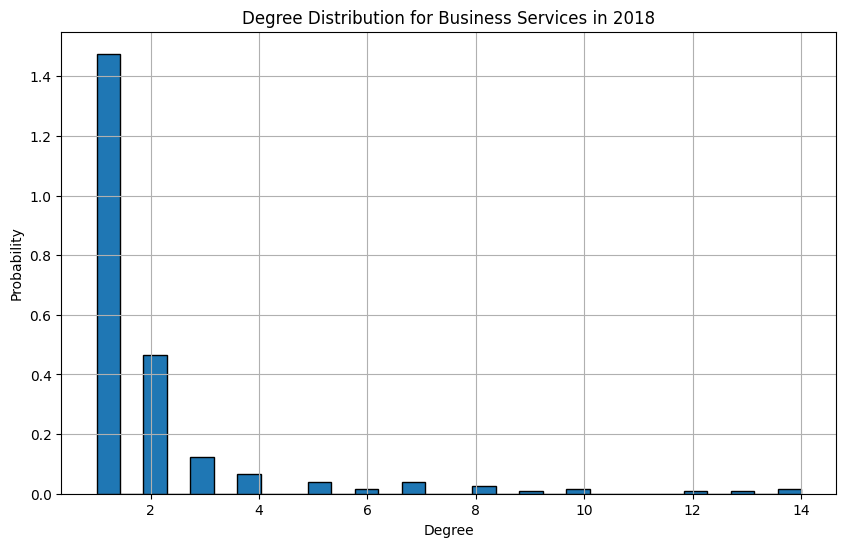

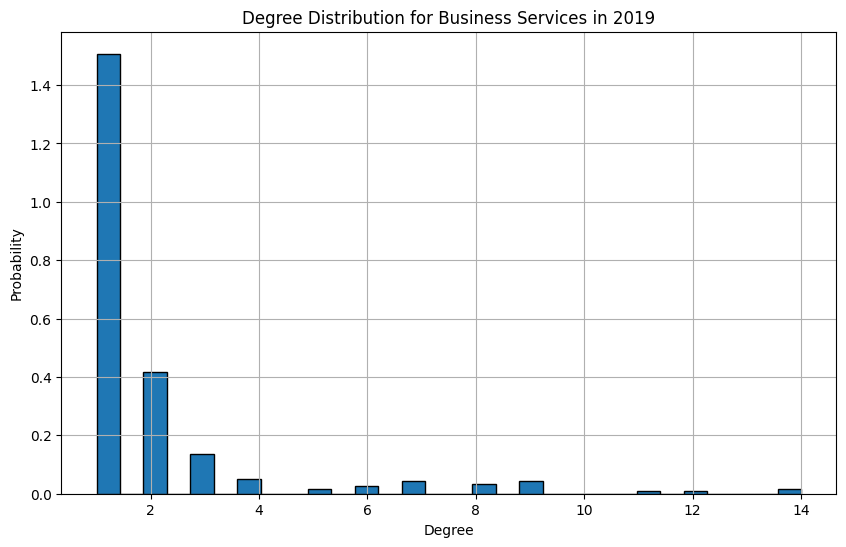

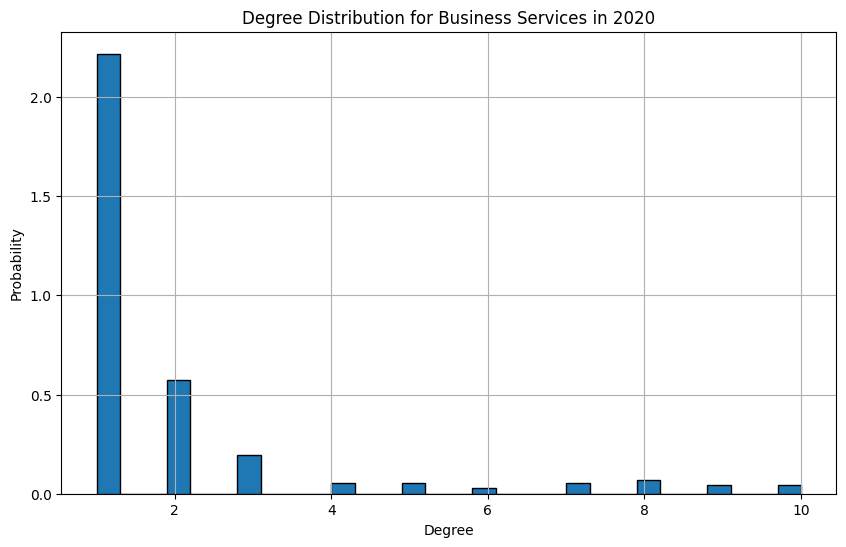

...

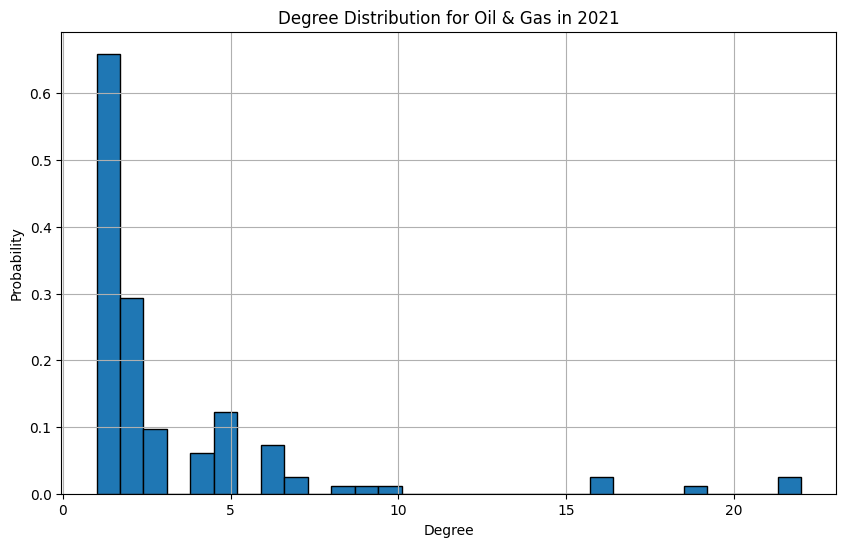

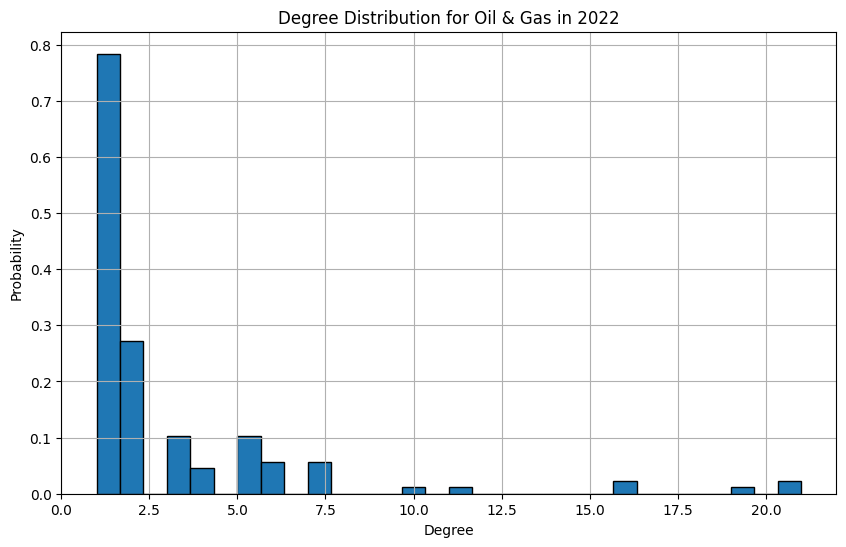

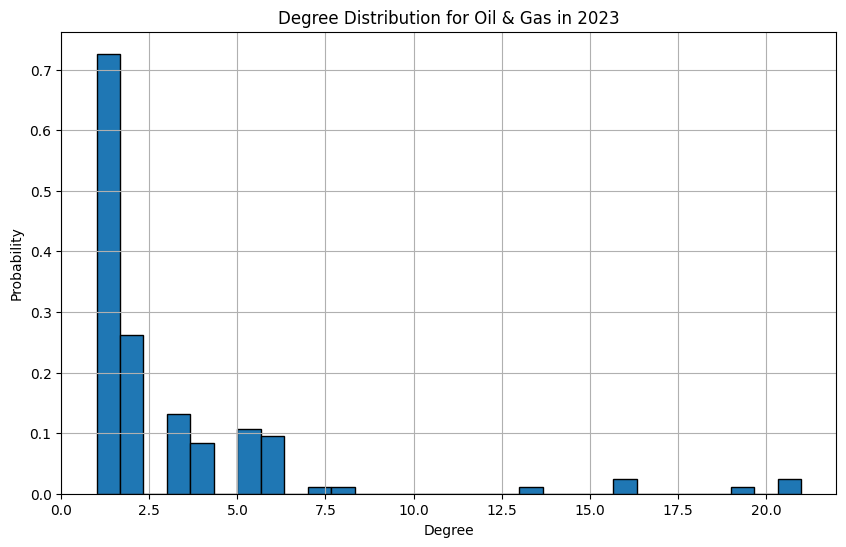

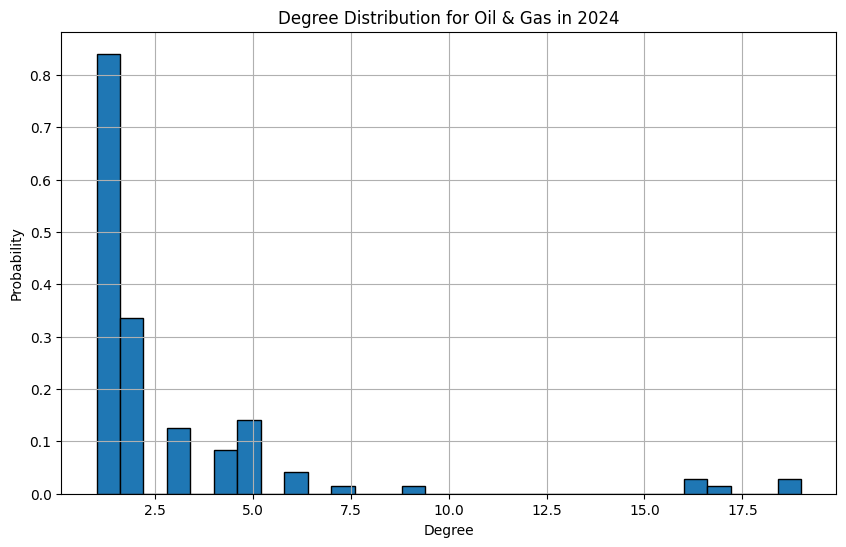

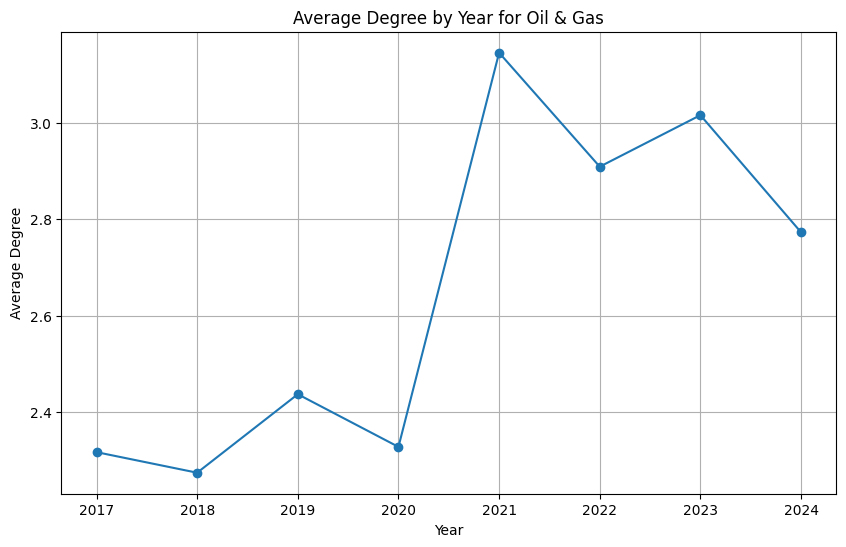

NameError: name 'assortativity_df' is not defined

In [ ]:
def calculate_degree_distribution_by_year(data):
    years = data['year'].unique()
    degree_distributions = []

    for year in years:
        yearly_data = data[data['year'] == year]

        G = nx.Graph()
        G.add_edges_from(zip(yearly_data['ISIN_x'], yearly_data['ISIN_y']))

        degrees = [deg for _, deg in G.degree()]
        average_degree = sum(degrees) / len(degrees) if degrees else 0

        degree_distributions.append({
            'Year': year,
            'Degrees': degrees,
            'Average Degree': average_degree
        })

    return degree_distributions

def calculate_degree_distribution_by_year_and_sector(data):
    years = data['year'].unique()
    sectors = data['Sector_x'].unique()
    degree_distributions = []

    for year in years:
        for sector in sectors:
            yearly_sector_data = data[(data['year'] == year) & (data['Sector_x'] == sector)]

            if yearly_sector_data.empty:
                continue

            G = nx.Graph()
            G.add_edges_from(zip(yearly_sector_data['ISIN_x'], yearly_sector_data['ISIN_y']))

            degrees = [deg for _, deg in G.degree()]
            average_degree = sum(degrees) / len(degrees) if degrees else 0

            degree_distributions.append({
                'Year': year,
                'Sector': sector,
                'Degrees': degrees,
                'Average Degree': average_degree
            })

    return degree_distributions

def plot_degree_distribution(degree_distributions):
    for distribution in degree_distributions:
        year = distribution['Year']
        degrees = distribution['Degrees']
        average_degree = distribution['Average Degree']

        plt.figure(figsize=(10, 6))
        plt.hist(degrees, bins=30, edgecolor='black', density=True)
        plt.title(f'Degree Distribution for {year}')
        plt.xlabel('Degree')
        plt.ylabel('Probability')
        plt.grid(True)
        plt.show()

        print(f'Year: {year}, Average Degree: {average_degree}')

    years = [dist['Year'] for dist in degree_distributions]
    average_degrees = [dist['Average Degree'] for dist in degree_distributions]

    plt.figure(figsize=(10, 6))
    plt.plot(years, average_degrees, marker='o')
    plt.title('Average Degree by Year')
    plt.xlabel('Year')
    plt.ylabel('Average Degree')
    plt.grid(True)
    plt.show()

def plot_degree_distribution_by_sector(degree_distributions):
    sectors = list(set(dist['Sector'] for dist in degree_distributions))
    for sector in sectors:
        sector_distributions = [dist for dist in degree_distributions if dist['Sector'] == sector]

        for distribution in sector_distributions:
            year = distribution['Year']
            degrees = distribution['Degrees']
            average_degree = distribution['Average Degree']

            plt.figure(figsize=(10, 6))
            plt.hist(degrees, bins=30, edgecolor='black', density=True)
            plt.title(f'Degree Distribution for {sector} in {year}')
            plt.xlabel('Degree')
            plt.ylabel('Probability')
            plt.grid(True)
            plt.show()

        years = [dist['Year'] for dist in sector_distributions]
        average_degrees = [dist['Average Degree'] for dist in sector_distributions]

        plt.figure(figsize=(10, 6))
        plt.plot(years, average_degrees, marker='o')
        plt.title(f'Average Degree by Year for {sector}')
        plt.xlabel('Year')
        plt.ylabel('Average Degree')
        plt.grid(True)
        plt.show()

def plot_assortativity(assortativity_df):
    plt.figure(figsize=(10, 6))
    plt.plot(assortativity_df['Year'], assortativity_df['Assortativity (Degree)'], label='Assortativity (Degree)', marker='o')
    plt.plot(assortativity_df['Year'], assortativity_df['Assortativity (Link)'], label='Assortativity (Link)', marker='x')
    plt.title('Assortativity by Year')
    plt.xlabel('Year')
    plt.ylabel('Assortativity')
    plt.legend()
    plt.grid(True)
    plt.show()


# Calculate the degree distribution for each year
degree_distributions = calculate_degree_distribution_by_year(data)
plot_degree_distribution(degree_distributions)

# Calculate the degree distribution for each year and sector
degree_distributions_by_sector = calculate_degree_distribution_by_year_and_sector(data)
plot_degree_distribution_by_sector(degree_distributions_by_sector)




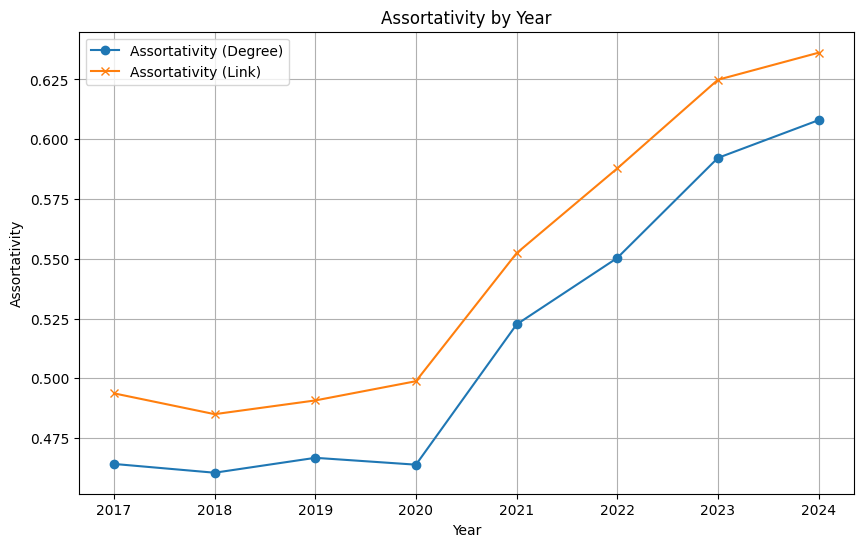

In [ ]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

def calculate_assortativity(G):
    # Assortativity based on node degree
    assortativity_degree = nx.degree_assortativity_coefficient(G)

    # Assortativity based on link contributions
    degrees_v = [G.degree(v) for v, _ in G.edges()]
    degrees_w = [G.degree(w) for _, w in G.edges()]
    assortativity_link = pd.Series(degrees_v).corr(pd.Series(degrees_w))

    return assortativity_degree, assortativity_link

def create_graph_from_year(data, year):

    yearly_data = data[data['year'] == year]

    G = nx.Graph()
    G.add_edges_from(zip(yearly_data['ISIN_x'], yearly_data['ISIN_y']))

    return G

def calculate_assortativity_by_year(data):
    years = data['year'].unique()
    assortativity_results = []

    for year in years:
        G = create_graph_from_year(data, year)
        assortativity_degree, assortativity_link = calculate_assortativity(G)

        assortativity_results.append({
            'Year': year,
            'Assortativity (Degree)': assortativity_degree,
            'Assortativity (Link)': assortativity_link
        })

    return pd.DataFrame(assortativity_results)

# Calculate assortativity for each year
assortativity_df = calculate_assortativity_by_year(data)

# Plot the assortativity
def plot_assortativity(assortativity_df):
    plt.figure(figsize=(10, 6))
    plt.plot(assortativity_df['Year'], assortativity_df['Assortativity (Degree)'], label='Assortativity (Degree)', marker='o')
    plt.plot(assortativity_df['Year'], assortativity_df['Assortativity (Link)'], label='Assortativity (Link)', marker='x')
    plt.title('Assortativity by Year')
    plt.xlabel('Year')
    plt.ylabel('Assortativity')
    plt.legend()
    plt.grid(True)
    plt.show()


plot_assortativity(assortativity_df)


In [ ]:
assortativity_df

,Year,Assortativity (Degree),Assortativity (Link)
0,2017,0.464189,0.493709
1,2018,0.460516,0.485002
2,2019,0.466751,0.490748
3,2020,0.463881,0.498791
4,2021,0.522533,0.552340
5,2022,0.550334,0.587777
6,2023,0.592170,0.624849
7,2024,0.607957,0.636161


In [ ]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np

# Function to run random walks and calculate stationary distribution
def run_random_walks(graph, num_walks=10000, walk_length=200):
    nodes = list(graph.nodes())
    stationary_probs = {node: 0 for node in nodes}

    for _ in range(num_walks):
        current_node = np.random.choice(nodes)
        for _ in range(walk_length):
            neighbors = list(graph.neighbors(current_node))
            if not neighbors:
                break
            current_node = np.random.choice(neighbors)
            stationary_probs[current_node] += 1

    # Normalize the stationary probabilities
    total_visits = sum(stationary_probs.values())
    stationary_probs = {node: count / total_visits for node, count in stationary_probs.items()}

    return stationary_probs

# Function to calculate stationary distributions by year
def calculate_stationary_distributions_by_year(data, num_walks=10000, walk_length=100):
    stationary_distributions = {}

    for year in data['year'].unique():
        # Filter data for the specific year
        yearly_data = data[data['year'] == year]

        # Create a graph and add edges with weights
        G = nx.Graph()
        G.add_weighted_edges_from(yearly_data[['ISIN_x', 'ISIN_y', 'Weight']].values)

        # Calculate stationary distribution
        stationary_distributions[year] = run_random_walks(G, num_walks=num_walks, walk_length=walk_length)

    return stationary_distributions

# Function to plot stationary distributions by year
def plot_stationary_distributions(stationary_distributions):
    for year, stationary_probs in stationary_distributions.items():
        plt.figure(figsize=(10, 6))
        plt.hist(stationary_probs.values(), bins=30, edgecolor='black', density=True)
        plt.title(f'Stationary Probability Distribution for {year}')
        plt.xlabel('Stationary Probability')
        plt.ylabel('Density')
        plt.grid(True)
        plt.show()

# Calculate the stationary distributions for each year
stationary_distributions = calculate_stationary_distributions_by_year(data)

# Plot the stationary distributions
plot_stationary_distributions(stationary_distributions)


In [ ]:
# Function to aggregate stationary probabilities by sector
def aggregate_probabilities_by_sector(stationary_distributions, company_sector_mapping):
    sector_probabilities_by_year = {}

    for year, probabilities in stationary_distributions.items():
        sector_probabilities = {}

        for company, probability in probabilities.items():
            sector = company_sector_mapping.get(company)
            if sector:
                sector_probabilities[sector] = sector_probabilities.get(sector, 0) + probability

        sector_probabilities_by_year[year] = sector_probabilities

    return sector_probabilities_by_year

# Function to plot sector stationary probabilities by year
def plot_sector_probabilities(sector_probabilities_by_year):
    for year, sector_probabilities in sector_probabilities_by_year.items():
        sectors = list(sector_probabilities.keys())
        probabilities = list(sector_probabilities.values())

        plt.figure(figsize=(10, 6))
        plt.bar(sectors, probabilities)
        plt.title(f'Sector Stationary Probabilities for {year}')
        plt.xlabel('Sector')
        plt.ylabel('Aggregate Stationary Probability')
        plt.xticks(rotation=90)
        plt.grid(True)
        plt.show()

# Create the company-sector mapping from both ISIN_x and ISIN_y
company_sector_mapping = pd.concat([
    data[['ISIN_x', 'Sector_x']].rename(columns={'ISIN_x': 'ISIN', 'Sector_x': 'Sector'}),
    data[['ISIN_y', 'Sector_y']].rename(columns={'ISIN_y': 'ISIN', 'Sector_y': 'Sector'})
]).drop_duplicates().set_index('ISIN')['Sector'].to_dict()

# Calculate stationary distributions for each year
stationary_distributions = calculate_stationary_distributions_by_year(data)

# Aggregate probabilities by sector
sector_probabilities_by_year = aggregate_probabilities_by_sector(stationary_distributions, company_sector_mapping)

# Plot the sector stationary probabilities
plot_sector_probabilities(sector_probabilities_by_year)

# **Fit Power Law Distribution to assess fit**

Calculating best minimal value for power law fit
Year: 2017, Power-law exponent (alpha): 4.83


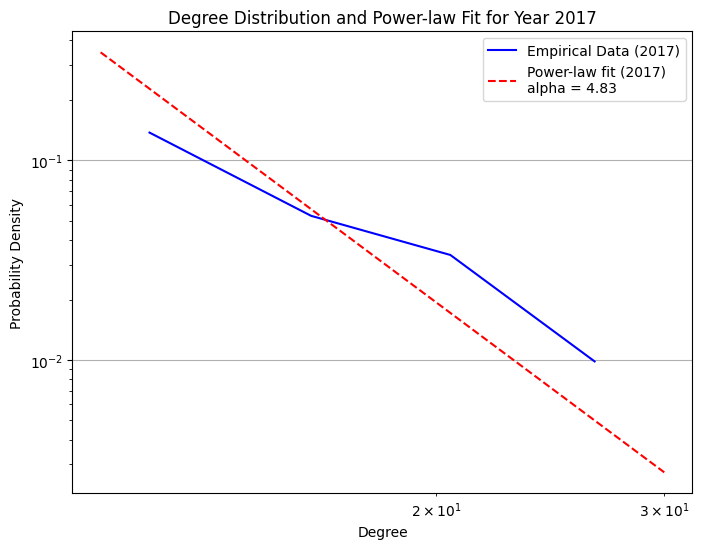

Calculating best minimal value for power law fit
Year: 2018, Power-law exponent (alpha): 5.40


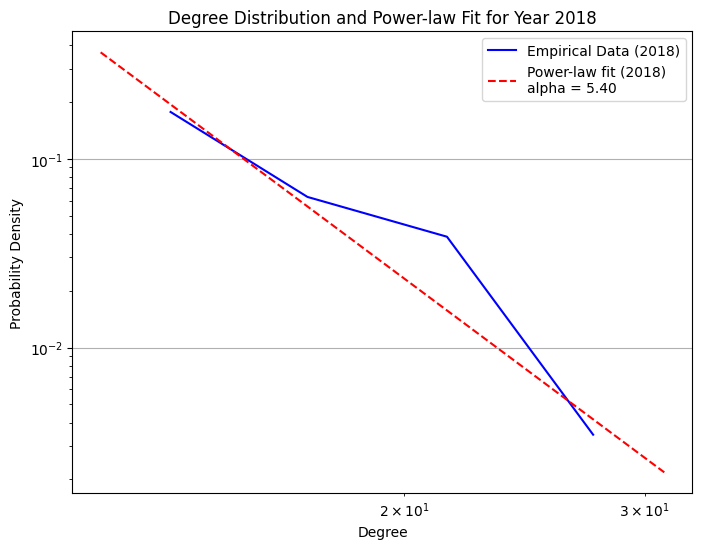

Calculating best minimal value for power law fit
Year: 2019, Power-law exponent (alpha): 4.57


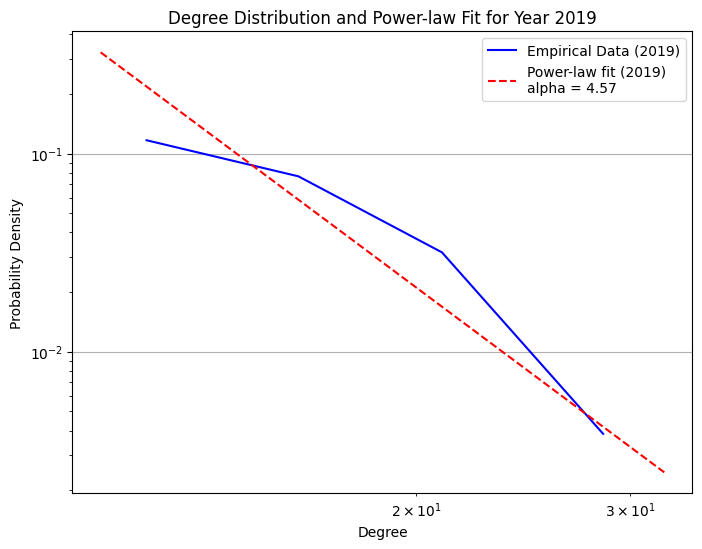

Calculating best minimal value for power law fit
Year: 2020, Power-law exponent (alpha): 5.57


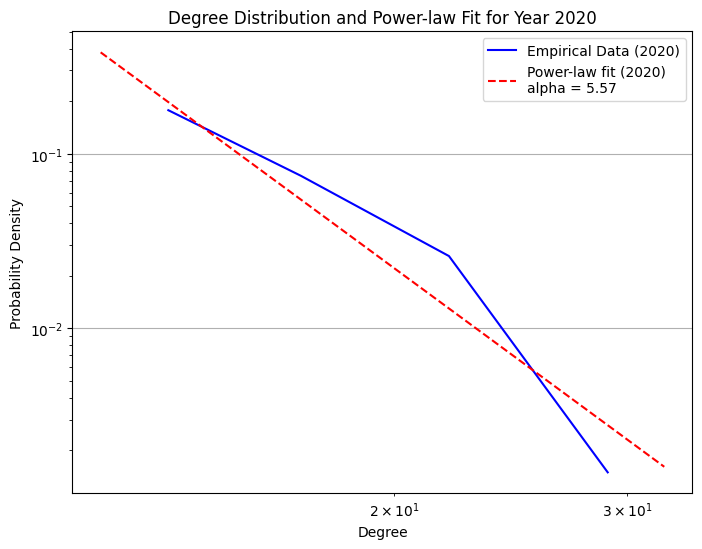

Calculating best minimal value for power law fit
Year: 2021, Power-law exponent (alpha): 3.97


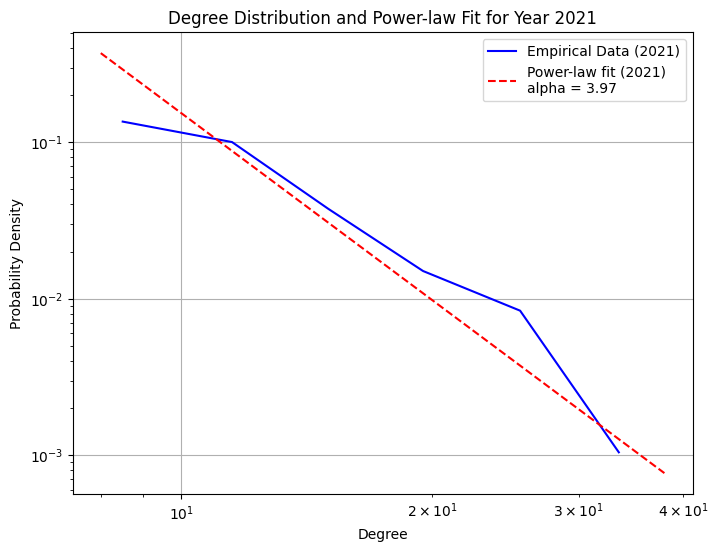

Calculating best minimal value for power law fit
Year: 2022, Power-law exponent (alpha): 4.46


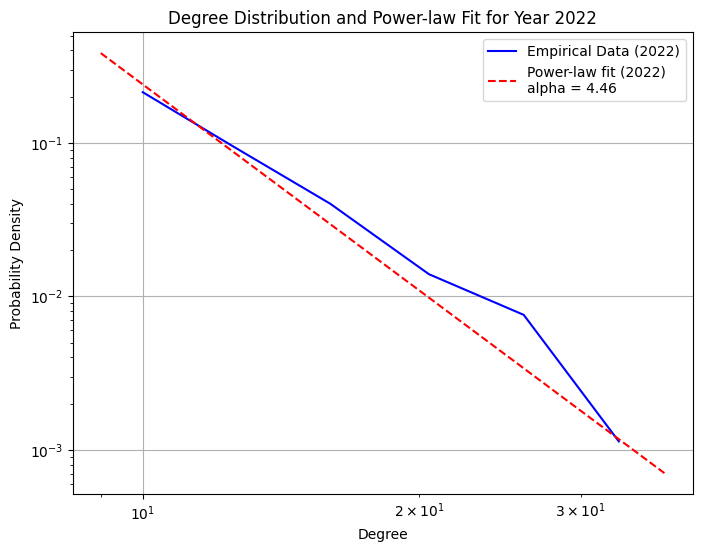

Calculating best minimal value for power law fit
Year: 2023, Power-law exponent (alpha): 5.03


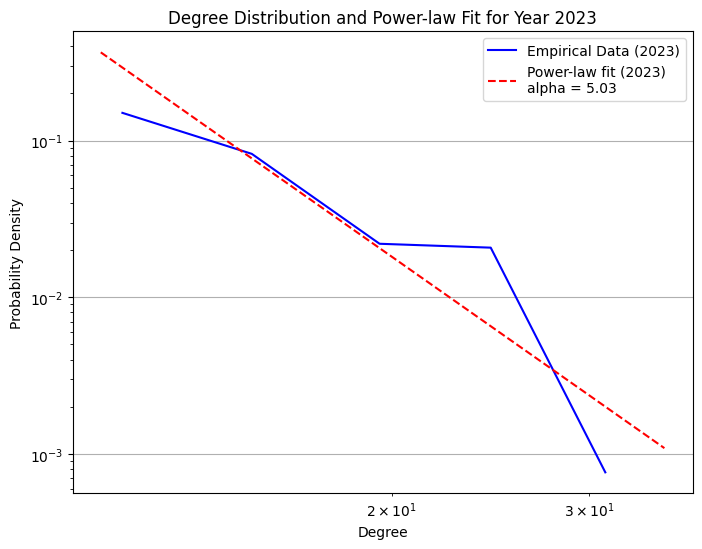

Calculating best minimal value for power law fit
Year: 2024, Power-law exponent (alpha): 5.01


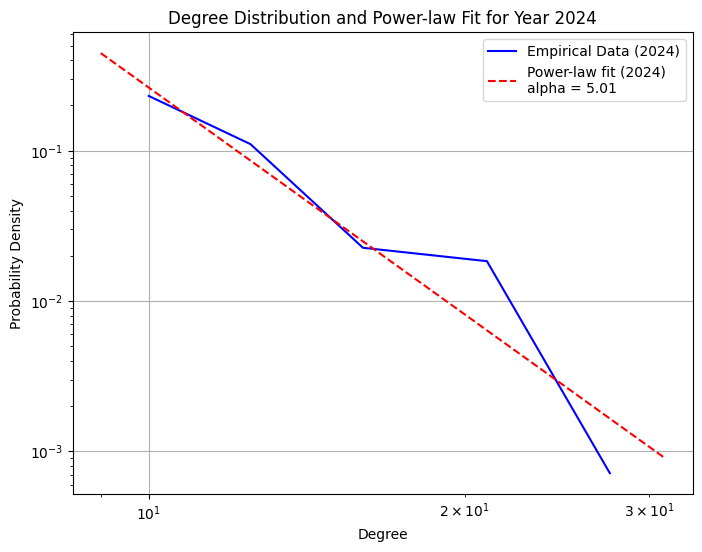


Power-law exponents by year:
Year 2017: Alpha = 4.83
Year 2018: Alpha = 5.40
Year 2019: Alpha = 4.57
Year 2020: Alpha = 5.57
Year 2021: Alpha = 3.97
Year 2022: Alpha = 4.46
Year 2023: Alpha = 5.03
Year 2024: Alpha = 5.01


In [ ]:
def calculate_degrees_and_power_law(df):
    degree_per_year_list = []
    power_law_exponents_by_year = {}

    for year in df['year'].unique():
        df_year = df[df['year'] == year]
        G = nx.Graph()
        G.add_edges_from(zip(df_year['ISIN_x'], df_year['ISIN_y']))

        # Calculate the degree for each company (node) in the graph
        degree_dict = dict(G.degree())
        degree_df = pd.DataFrame(list(degree_dict.items()), columns=['Company', 'degree'])
        degree_df['year'] = year

        degree_per_year_list.append(degree_df)

        # Fit the power-law distribution for this year
        degrees_for_year = degree_df['degree']
        fit = powerlaw.Fit(degrees_for_year)
        power_law_exponents_by_year[year] = fit.power_law.alpha

        # Print and plot the power-law exponent and degree distribution
        print(f"Year: {year}, Power-law exponent (alpha): {fit.power_law.alpha:.2f}")

        fig = plt.figure(figsize=(8, 6))
        fit.plot_pdf(label=f'Empirical Data ({year})', color='b')
        fit.power_law.plot_pdf(label=f'Power-law fit ({year})\nalpha = {fit.power_law.alpha:.2f}', color='r', linestyle='--')

        plt.title(f'Degree Distribution and Power-law Fit for Year {year}')
        plt.xlabel('Degree')
        plt.ylabel('Probability Density')
        plt.legend()
        plt.grid(True)
        plt.show()

    return degree_per_year_list, power_law_exponents_by_year

degree_per_year_list, power_law_exponents_by_year = calculate_degrees_and_power_law(df)

print("\nPower-law exponents by year:")
for year, exponent in power_law_exponents_by_year.items():
    print(f"Year {year}: Alpha = {exponent:.2f}")


# **K-Core Decomposition**

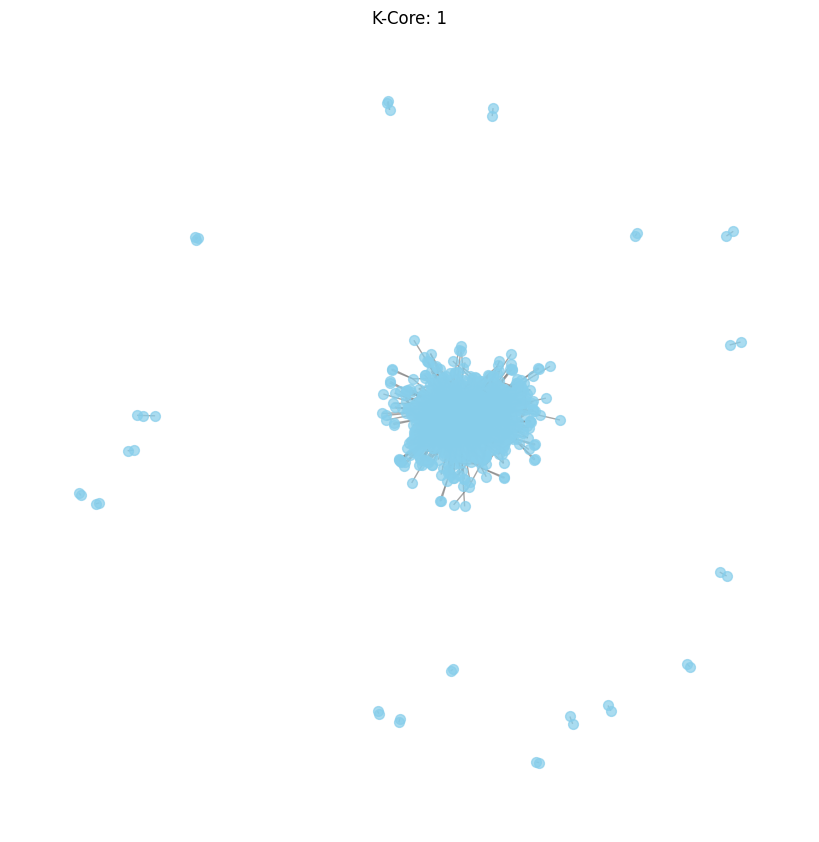

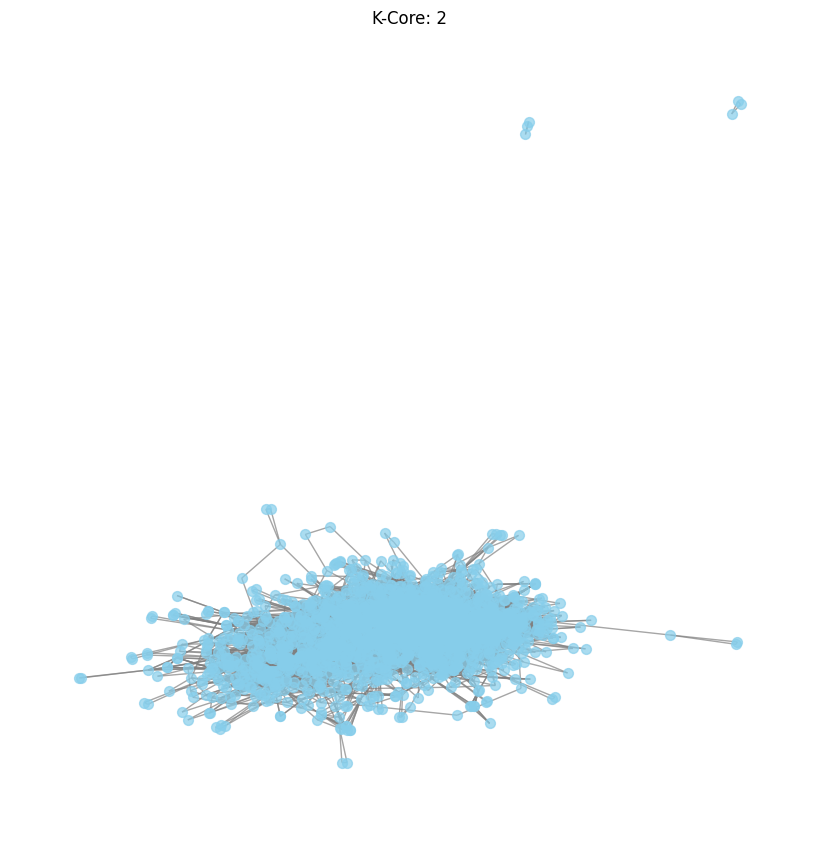

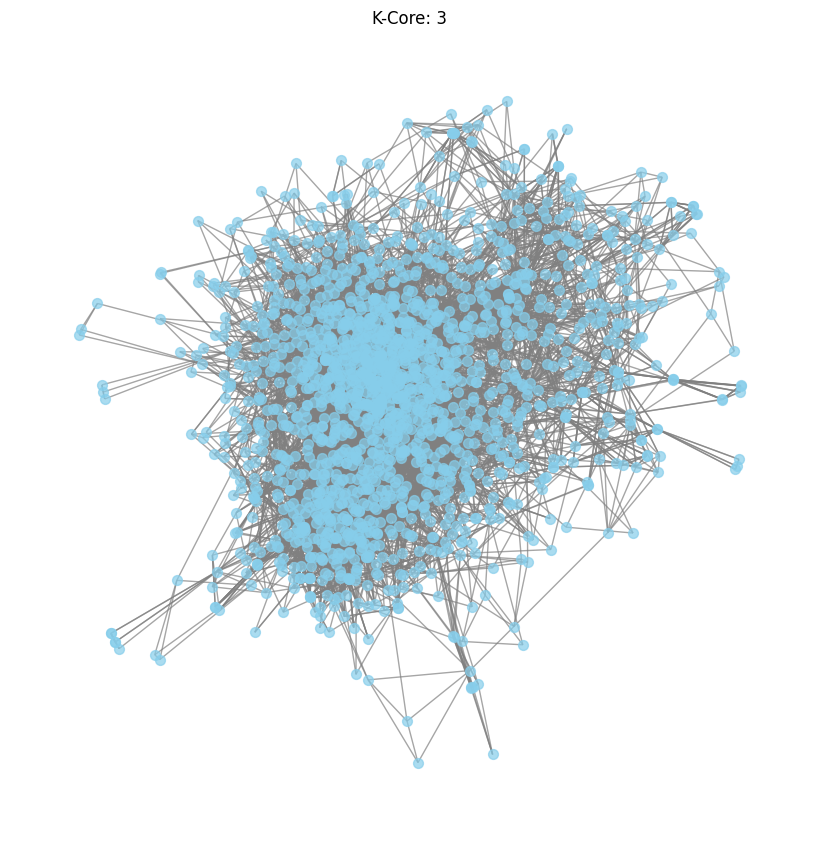

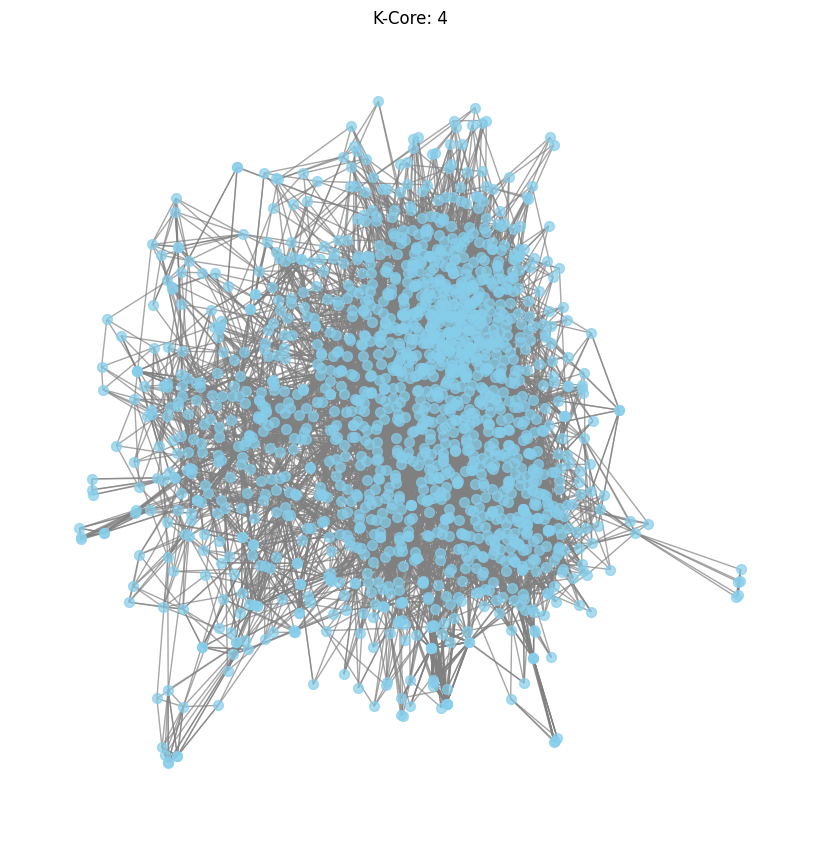

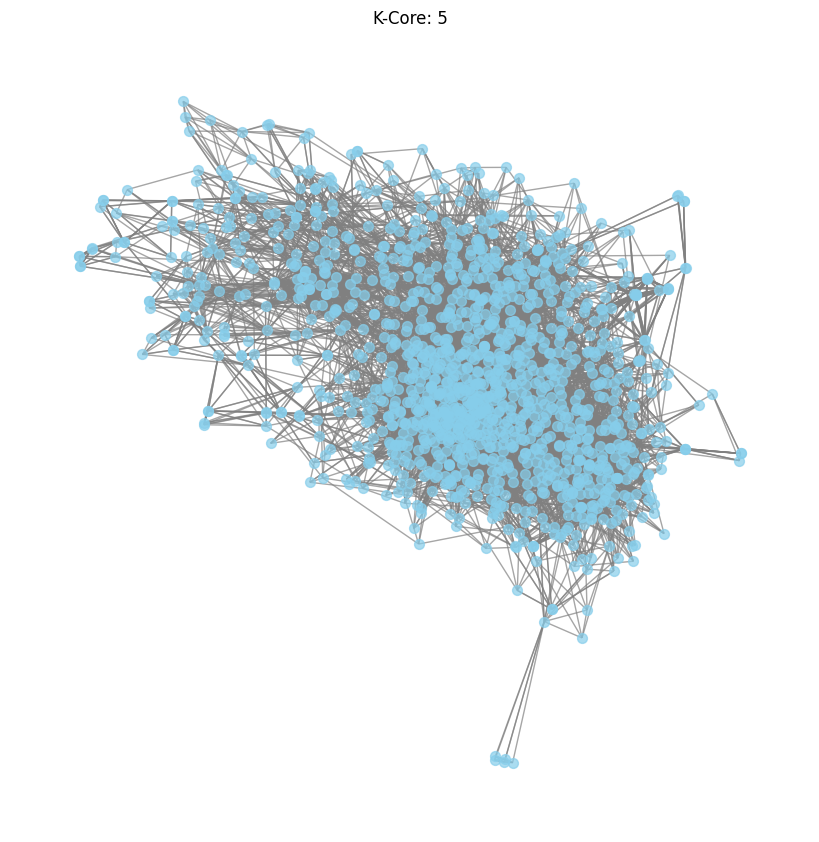

...

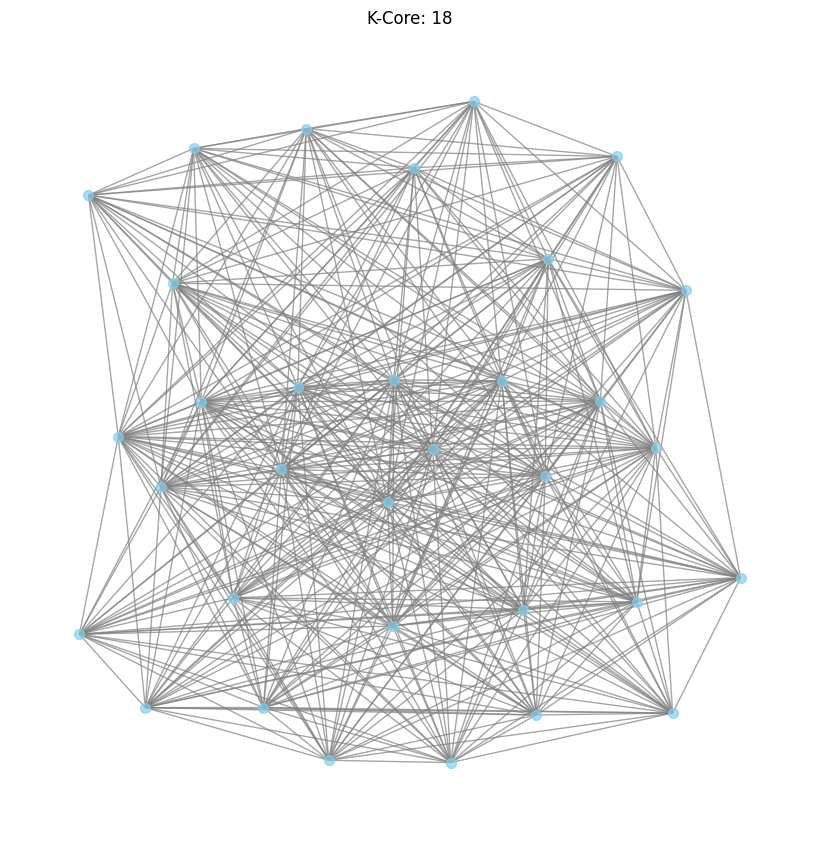

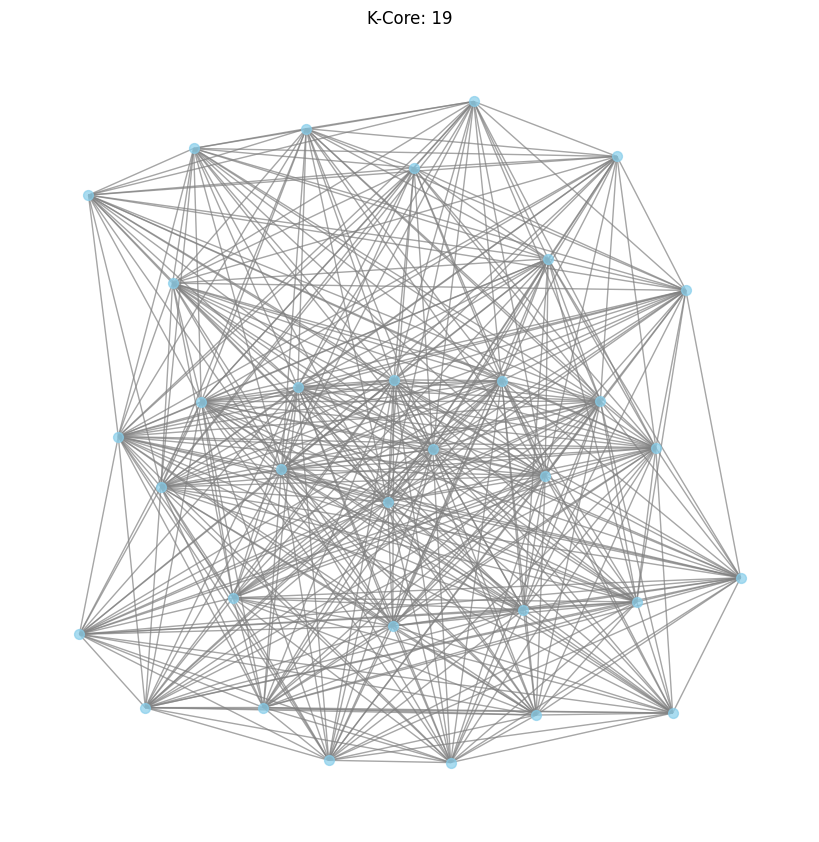

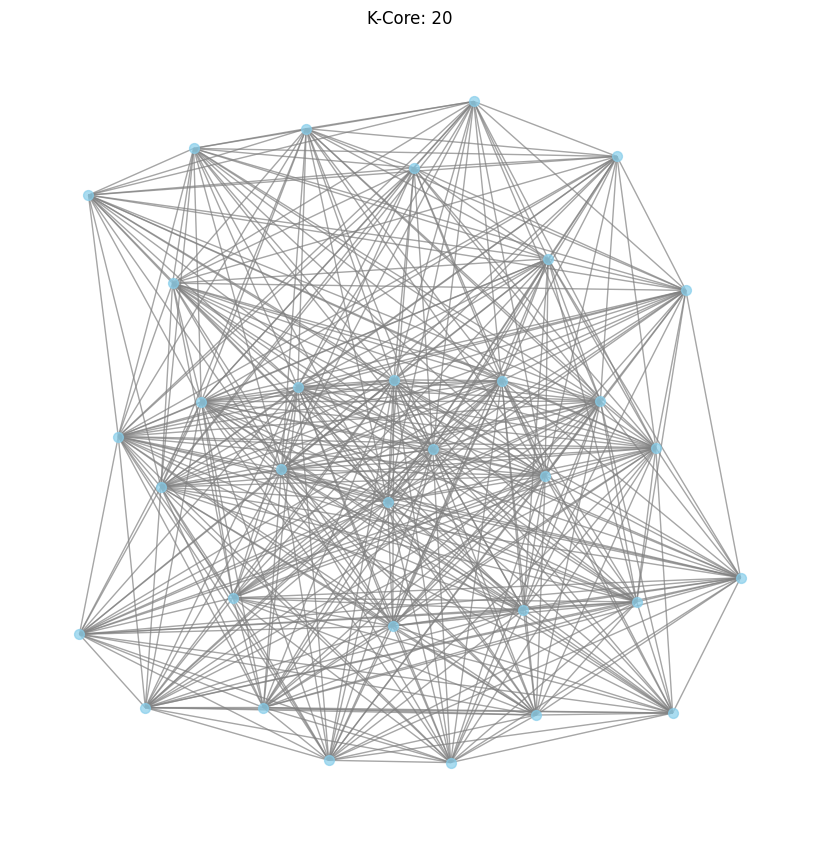

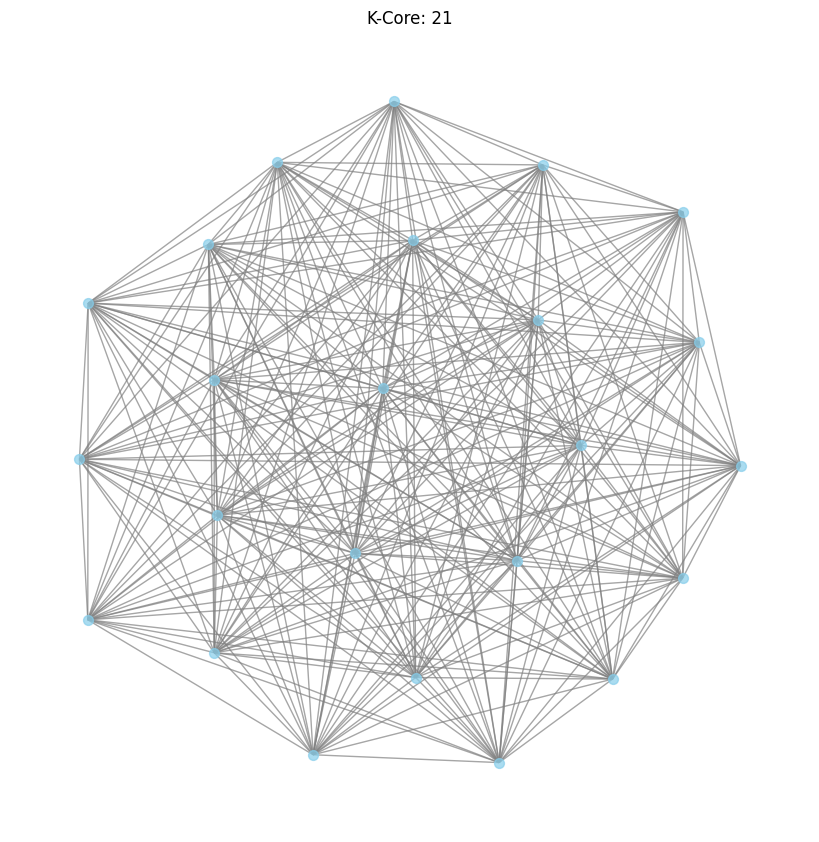

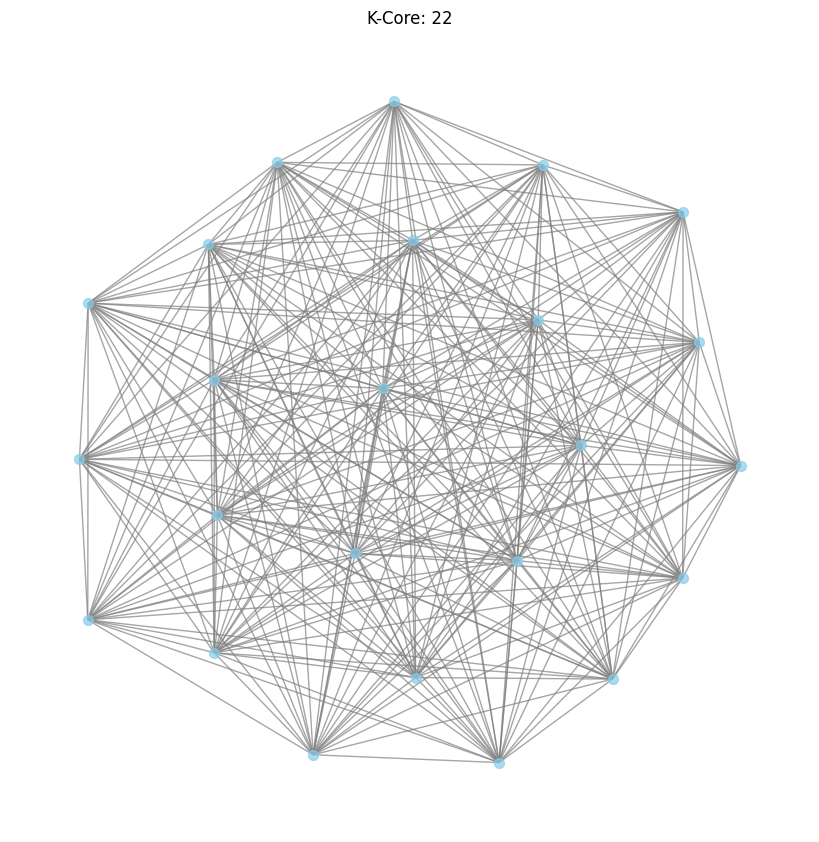

In [ ]:
# Create the NetworkX graph from the edge list
G_combined = nx.from_pandas_edgelist(df, source='ISIN_x', target='ISIN_y', edge_attr='Weight')

# Compute the core numbers for each node
core_numbers = nx.core_number(G_combined)

# Find the maximum k-core value to determine the number of layers
max_k = max(core_numbers.values())

# Function to visualize each k-core using NetworkX
def visualize_k_core(G, k):
    G_k_core = nx.k_core(G, k=k)

    pos = nx.spring_layout(G_k_core, seed=42)

    plt.figure(figsize=(8, 8))
    nx.draw(G_k_core, pos, with_labels=False, node_size=50, node_color='skyblue', edge_color='gray', alpha=0.7)
    plt.title(f"K-Core: {k}")
    plt.axis('off')
    plt.show()

for k in range(1, max_k + 1):
    visualize_k_core(G_combined, k)
